# Who has access to LA's parks?

Since the pandemic began, a person's ability to maintain good physical and mental health has become even more dependent on their access to outdoor spaces. 

Therefore, we want to know: **How accessible are parks and other public recreation facilities in the lowest income neighborhoods and highest income neighborhoods in Los Angeles, CA?**

Our hypothesis is that we will find fewer parks in lower income areas than the higher income areas.

We will explore this question by creating charts, static maps, and interactive maps to better understand the socioeconomic landscape of Los Angeles. Let's jump in!

<img src="https://studio-mla.com/wp-content/uploads/2017/09/Studio-MLA_Vista-Hermosa-10_Hunter-Kerhart_WEB.jpg" width=600>

## Data sources
We based our research on the following data sources:

[LA city income data from the U.S. Census Bureau](https://censusreporter.org/profiles/16000US0644000-los-angeles-ca/)

[Park data from the County of Los Angeles Department of Parks and Recreation](https://data.lacity.org/Community-Economic-Development/Department-of-Recreation-and-Parks-Facility-and-Pa/ax8j-dhzm)

## Importing the libraries
The first thing we need to do is import all of the libraries that will allow us to explore our data and create our beautiful charts and maps.

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
import plotly.express as px




/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


## Analyzing LA incomes by census tract
We will create some charts that will help us compare the median household per income of all LA census tracts. We will do this to identify which census tracts are of interest to us for our research. The charts we will create include:

- City of Los Angeles Census Tract Income Frequency
- Top 10 Census Tracts with Lowest Incomes in the City of Los Angeles
- Top 10 Census Tracts with Highest Incomes in the City of Los Angeles

### Importing the data
First we need to import our income data.

In [2]:
income1=pd.read_csv('Data1/Income_KB2_.csv')
income1.head()

,geoid,Census_Tract,Median_Household_Income,Median_Household_Income_<50K,Median_Household_Income_<100K,Median_Household_Income_<250K
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,NaN,NaN,250001.0
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,NaN,NaN,250001.0
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,NaN,NaN,250001.0
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,NaN,NaN,231250.0
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,NaN,NaN,224962.0


### Statistical Analysis and charts
Now we can start our analysis and create our charts.

We will find the mean for each income group and then use a function to produce histogram charts for median household income of different income groups. In this case, the income groups are Median_Household_Income_<50K, Median_Household_Income_<100K, and Median_Household_Income_<250K.

In [3]:
indicators = [ 'Median_Household_Income','Median_Household_Income_<50K',
 'Median_Household_Income_<100K',
 'Median_Household_Income_<250K',]

In [4]:
for indicator in indicators:
    print ('mean for ' + indicator + ' is ' + str(income1[indicator].mean()))

mean for Median_Household_Income is 68203.51512096774
mean for Median_Household_Income_<50K is 38839.10969387755
mean for Median_Household_Income_<100K is 71712.97571743929
mean for Median_Household_Income_<250K is 135693.72789115645


We learned that the lowest average income for the census tracts is lower than $40,000

In [5]:
def get_histogram(column = 'Median_Household_Income'):
    series_to_plot=income1[column]

    plt.figure(figsize=(10,5))

    plt.hist(series_to_plot,bins=50,color='skyblue')

    plt.axvline(series_to_plot.mean(), color='k', linestyle='dashed', linewidth=1)
    plt.axvline(series_to_plot.median(), color='r', linestyle='dashed', linewidth=1)
    min_ylim, max_ylim = plt.ylim()
    plt.text(series_to_plot.mean()*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(series_to_plot.mean()))
    plt.text(series_to_plot.median()*1.1, max_ylim*0.8, 'Median: {:.2f}'.format(series_to_plot.median()),color='r')
    plt.title(column + ' in Los Angeles')

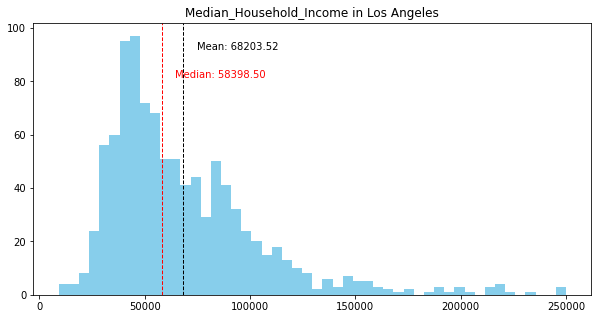

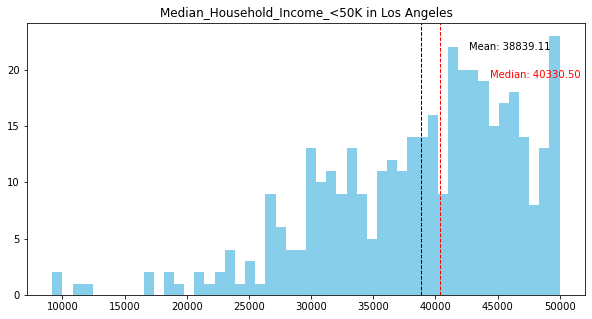

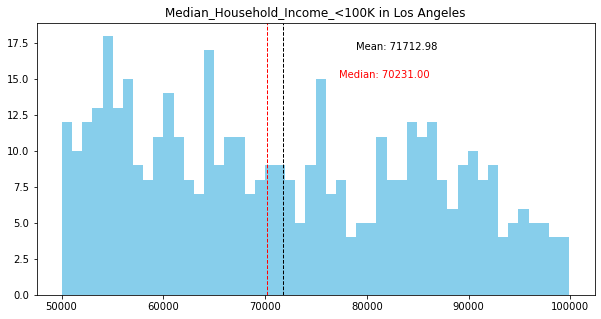

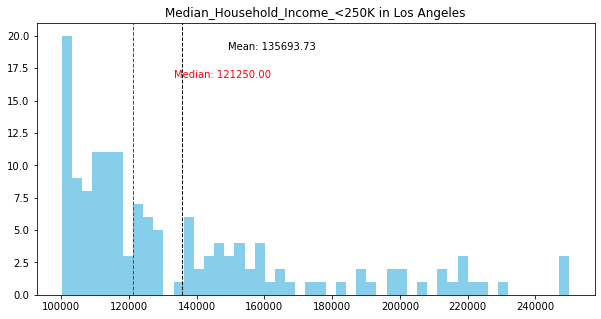

In [6]:
for indicator in indicators:
    get_histogram(column=indicator)

Wow!!! The histograms are really insightful in visually presenting the distribution of median and mean household incomes of different census tracts.

Now we want to get started on creating charts of the top 10 census tracts with the lowest and highest median household incomes. The first thing we need to do is to sort our data set by income and create variables that will store the sorted data. Then we can create an income bar chart of the lowest incomes.

In [7]:
lowest_incomes = income1.sort_values(by='Median_Household_Income',ascending = True)
highest_incomes = income1.sort_values(by='Median_Household_Income',ascending = False)

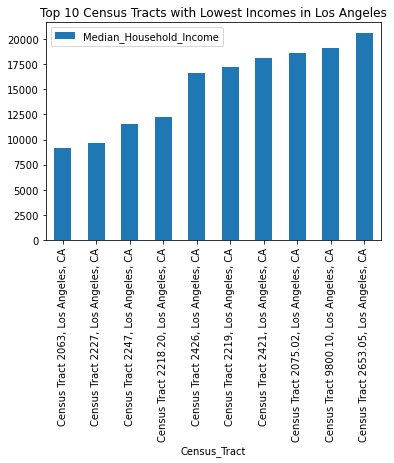

In [8]:
lowest_incomes.head(10).plot.bar(x='Census_Tract',
                            y='Median_Household_Income', 
                            title='Top 10 Census Tracts with Lowest Incomes in Los Angeles')

The output of our code is a chart titled "Top 5 Census Tracts with Lowest Incomes in the City of Los Angeles", which has census tracts in the x axis and median household income in the y axis. From this chart, we learn that the census tracts with the lowest median household incomes have incomes ranging from below 10,000 to slightly above 20,000.

Now we can make a chart for the highest incomes.

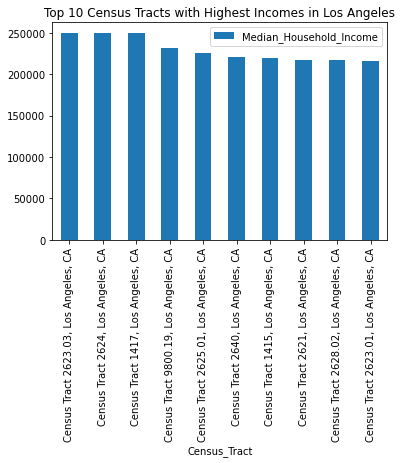

In [9]:
highest_incomes.head(10).plot.bar(x='Census_Tract',
                            y='Median_Household_Income', 
                            title='Top 10 Census Tracts with Highest Incomes in Los Angeles')

The output of our code is a chart titled "Top 5 Census Tracts with Highest Incomes in the City of Los Angeles", which has census tracts in the x axis and median household income in the y axis. From this chart we learn that the census tracts with the highest median household incomes have incomes around $250,000. 

All of these charts help us understand what the income distribution looks like between LA census tracts. With this information we can identify the high and low income census tracts and compare their park access.

## Mapping parks and income 
Perfect! Now that we have created our charts, the next thing we want to do is create interactive maps featuring income and park layers.

### Cleaning the Data
We need to do some data cleaning before we create the maps. Looking at the bottom of this chart we can see that there are some null values we want to get rid of.

In [10]:
income2=gpd.read_file('Data2/Income_KB.geojson')
columns_to_keep2 = ['geoid','name','B19013001','geometry']
income2 = income2[columns_to_keep2]
income2.columns = ['geoid',
 'Census_Tract',
 'Median_Household_Income',
 'geometry']
income2.head()

,geoid,Census_Tract,Median_Household_Income,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


Let's see how many null values there are.

In [11]:
lowest_incomes2 = income2.sort_values(by='Median_Household_Income',ascending = True)
lowest_incomes2.tail(15)

,geoid,Census_Tract,Median_Household_Income,geometry
340,14000US06037141700,"Census Tract 1417, Los Angeles, CA",250001.0,"MULTIPOLYGON (((-118.45322 34.13557, -118.4531..."
831,14000US06037262303,"Census Tract 2623.03, Los Angeles, CA",250001.0,"MULTIPOLYGON (((-118.49599 34.07105, -118.4959..."
832,14000US06037262400,"Census Tract 2624, Los Angeles, CA",250001.0,"MULTIPOLYGON (((-118.52146 34.11764, -118.5214..."
847,14000US06037265301,"Census Tract 2653.01, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.45549 34.07585, -118.4546..."
989,14000US06037980008,"Census Tract 9800.08, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.50267 34.22121, -118.5015..."
990,14000US06037980009,"Census Tract 9800.09, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.33707 34.14160, -118.3361..."
992,14000US06037980014,"Census Tract 9800.14, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.26088 33.76850, -118.2602..."
995,14000US06037980020,"Census Tract 9800.20, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.34412 34.21700, -118.3438..."
996,14000US06037980021,"Census Tract 9800.21, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.40183 34.26509, -118.4017..."
997,14000US06037980022,"Census Tract 9800.22, Los Angeles, CA",NaN,"MULTIPOLYGON (((-118.50266 34.30809, -118.5026..."


Now we will get rid of the null values.

In [12]:
income2 = income2.drop([847, 989, 990, 992, 995, 996, 997, 998, 1000, 1001, 1002, 1003])

### Creating the static maps

Before we begin to create our interactive map, we should first create a nice static map of median household incomes. This will allow us to really visualize where the higher income and lower income communities are in Los Angeles. Having these communities in mind will help us be more intentional when we bring in our park data!

Text(0.5, 1.0, 'Census Tracts with median household incomes less than $125,000')

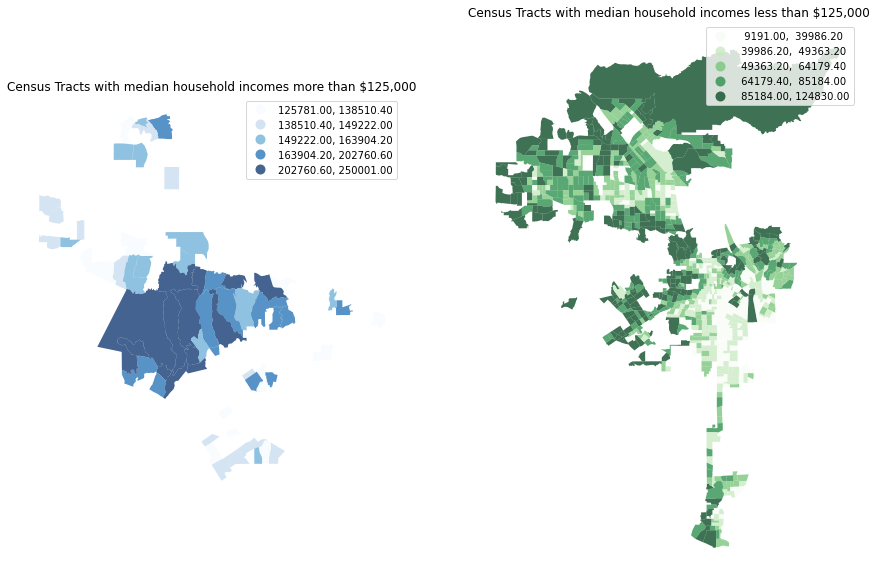

In [13]:
fig, axs = plt.subplots(1, 2, figsize=(15, 12))

ax1, ax2 = axs

income2[income2.Median_Household_Income > 125000].plot(column='Median_Household_Income',
            cmap='Blues',
            scheme='quantiles',
            k=5,
            edgecolor='white',
            linewidth=0.,
            alpha=0.75,
            ax=ax1, # this assigns the map to the subplot,
            legend=True
           )

ax1.axis("off")
ax1.set_title("Census Tracts with median household incomes more than $125,000")

income2[income2.Median_Household_Income < 125000].plot(column='Median_Household_Income',
            cmap='Greens',
            scheme='quantiles',
            k=5,
            edgecolor='white',
            linewidth=0.,
            alpha=0.75,
            ax=ax2, # this assigns the map to the subplot
            legend=True
           )

ax2.axis("off")
ax2.set_title("Census Tracts with median household incomes less than $125,000")

TWO MAPS?!?! WOW! One map features the bottom half of median household incomes and one features the upper half of median household incomes in Los Angeles. These maps show that the higher income communities are concentrated in hills and valleys north west of Los Angeles. Conversely, the lower income communities are spread around Los Angeles, with the lowest incomes being in the South LA area.

### Creating the interactive map
Now we can get started on creating our interactive data maps! We will first make an interactive choropleth map that shades the census tracts according to how high or low their median household income is. We are able to hover over each census tract to see the census tract number.

In [14]:
m = folium.Map(location=[34.047456965444866, -118.33890904246935], 
               zoom_start = 10,
               tiles='OpenStreetMap', 
               attribution='CartoDB')

choropleth = folium.Choropleth(
                  geo_data=income2, 
                  data=income2,         
                  key_on='feature.properties.Census_Tract',
                  columns=['Census_Tract', 'Median_Household_Income'],
                  fill_color='RdBu',
                  line_weight=1, 
                  fill_opacity=0.8,
                  line_opacity=0.5, 
                  legend_name='Median Household Income per Census Tract (ACS 2019 5-Year Estimates)').add_to(m)   

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['Census_Tract'],labels=False)
)
m


How beautiful!! The census tracts with higher incomes have a darker red color. This color scheme is presented in the key in the top right.

Now let's add our parks and recreational facilities to our income layer.

In [15]:
parks = pd.read_csv('Data3/PR1.csv')
parks.head()

,LocationType,Location_Name,StNumber,StNumberFraction,StDirection,StName,StSuffix,StSuffixDirection,AddressType,AddressTypeValue,...,CrossStSuffix,CrossStSuffixDirection,City,State,Zip,Website,Phone,CouncilDistrict,X,Y
0,Parks,La Mirada Park Acquisition Site,5401.0,NaN,W,La Mirada,Ave,NaN,NaN,NaN,...,NaN,NaN,"Los Angeles, CA 90029\n(34.0942, -118.307)",CA,90029,NaN,(310) 548-7675,13,34.094208,-118.306999
1,Gardens,Drew St,3304.0,NaN,N,Drew,St,NaN,NaN,NaN,...,NaN,NaN,"Los Angeles, CA 90065\n(34.12, -118.243)",CA,90065,NaN,(213) 485-5572,13,34.119958,-118.242682
2,Parks,Avalon-San Pedro Park,4025.0,NaN,NaN,Avalon,Blvd,NaN,NaN,NaN,...,NaN,NaN,"Los Angeles, CA 90011\n(34.0104, -118.266)",CA,90011,NaN,(310) 548-7675,9,34.010389,-118.265542
3,Parks,11th Avenue Park,6116.0,NaN,NaN,11th,Ave,NaN,NaN,NaN,...,NaN,NaN,"Los Angeles, CA 90043\n(33.9845, -118.329)",CA,90043,NaN,(310) 548-7675,8,33.984488,-118.329232
4,Gardens,El Sereno Community Garden,5450.0,NaN,E,Huntington,Dr,NaN,NaN,NaN,...,NaN,NaN,"Los Angeles, CA 90032\n(34.0923, -118.162)",CA,90032,NaN,(213) 485-5572,14,34.092346,-118.161574


Now we can create our interactive map that shows both both census tracts and park locations. You can hover over the census tract to see which tract it is. You can also hover over the markers to see the park names.

In [16]:
for index, row in parks.iterrows():
    tooltip_text = row.Location_Name
    folium.Marker(
        [row.X,row.Y], 
        popup=row.Location_Name, 
        tooltip=tooltip_text,
        icon=folium.Icon(color='green', icon="map-marker"),
).add_to(m)

m

In [17]:
m.save('Census and Parks.html')

There are so many parks that is hard to make sense of the map so we are going to make a marker cluster map so it is easier to understand.

In [18]:
c = folium.Map(location=[34.047456965444866, -118.33890904246935], 
               zoom_start = 11,
               tiles='OpenStreetMap', 
               attribution='CartoDB')

folium.Choropleth(
                  geo_data=income2, 
                  data=income2,         
                  key_on='feature.properties.Census_Tract',
                  columns=['Census_Tract', 'Median_Household_Income'],
                  fill_color='RdBu',
                  line_weight=1, 
                  fill_opacity=0.8,
                  line_opacity=0.5, 
                  legend_name='Median Household Income per Census Tract (ACS 2019 5-Year Estimates)').add_to(c)   

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['Census_Tract'],labels=False)
)


marker_cluster = MarkerCluster().add_to(c)

for index,row in parks.iterrows():
    folium.Marker(
        location=[row.X,row.Y],
        popup=row.Location_Name,
        icon=folium.Icon(color='green', icon="map-marker"),
    ).add_to(marker_cluster)

c

In [19]:
c.save('Parks cluster.html')

This map makes it a bit easier to see which areas have the most parks. However, we think this would be even easier to see if we run a count of parks in the census tracts and then make a map out of it.

### Merging the data
Before we can make a map of the number of parks per census tract we need to merge our data.

In [20]:
parks_listings = gpd.GeoDataFrame(parks,   geometry=gpd.points_from_xy(parks.Y, parks.X))
type(parks_listings)

geopandas.geodataframe.GeoDataFrame

In [21]:
parksss = parks_listings.set_crs("EPSG:4326")
incomepark = gpd.sjoin(income2,parksss)

Now that our data is projected and joined, we can group our data to create a count of how many parks are located in each census tract. 

In [22]:
grouped = incomepark.groupby('Census_Tract').size()
df = grouped.to_frame().reset_index()
df.columns = ['Census_Tract', 'listings_count']
df

,Census_Tract,listings_count
0,"Census Tract 1095, Los Angeles, CA",2
1,"Census Tract 1216, Los Angeles, CA",1
2,"Census Tract 1221.22, Los Angeles, CA",1
3,"Census Tract 1242.01, Los Angeles, CA",1
4,"Census Tract 1287.02, Los Angeles, CA",1
...,...,...
192,"Census Tract 2920, Los Angeles, CA",1
193,"Census Tract 2965, Los Angeles, CA",1
194,"Census Tract 7011, Los Angeles, CA",2
195,"Census Tract 9800.10, Los Angeles, CA",11


Let's add the listings count column to the rest of our spatial join data

In [23]:
merged = incomepark.merge(df, on='Census_Tract')
merged.head()

,geoid,Census_Tract,Median_Household_Income,geometry,index_right,LocationType,Location_Name,StNumber,StNumberFraction,StDirection,...,CrossStSuffixDirection,City,State,Zip,Website,Phone,CouncilDistrict,X,Y,listings_count
0,14000US06037109500,"Census Tract 1095, Los Angeles, CA",33387.0,"MULTIPOLYGON (((-118.45528 34.27935, -118.4552...",146,Outdoor Fitness Equipment,Fox & Laurel Park,14353.0,NaN,NaN,...,NaN,"Los Angeles, CA 91340\n(34.2716, -118.446)",CA,91340,NaN,NaN,7,34.271638,-118.446271,2
1,14000US06037109500,"Census Tract 1095, Los Angeles, CA",33387.0,"MULTIPOLYGON (((-118.45528 34.27935, -118.4552...",218,Parks,Fox & Laurel Park,14353.0,NaN,NaN,...,NaN,"Los Angeles, CA 91340\n(34.2716, -118.446)",CA,91340,NaN,NaN,7,34.271638,-118.446271,2
2,14000US06037121600,"Census Tract 1216, Los Angeles, CA",79474.0,"MULTIPOLYGON (((-118.41439 34.21985, -118.4129...",56,Parks,Bellaire Avenue Park,7960.0,NaN,N,...,NaN,"Los Angeles, CA 91605\n(34.2156, -118.413)",CA,91605,NaN,(818) 506-7456,2,34.215610,-118.412666,1
3,14000US06037122122,"Census Tract 1221.22, Los Angeles, CA",41811.0,"MULTIPOLYGON (((-118.37948 34.22330, -118.3774...",86,Swimming Pools - Summer,Sun Valley Park Pool,8123.0,NaN,NaN,...,NaN,"Los Angeles, CA 91352\n(34.2182, -118.37)",CA,91352,http://www.laparks.org/dos/aquatic/facility/su...,(818) 252-0835,6,34.218154,-118.370428,1
4,14000US06037124201,"Census Tract 1242.01, Los Angeles, CA",64364.0,"MULTIPOLYGON (((-118.37905 34.18853, -118.3790...",49,Parks,Victory - Vineland Park,11117.0,NaN,NaN,...,NaN,"Los Angeles, CA 91606\n(34.1869, -118.373)",CA,91606,http://www.laparks.org/dos/parks/facility/vict...,(818) 985-9516,2,34.186926,-118.372700,1


### Parks and recreation facilities per census tract map
Now that our data is projected, joined, merged etc, it is ready to be presented as a folium map! Like we mentioned earlier, our goal is to visually present the census tracts with the amount of parks and facilities that they contain.

In [24]:
b = folium.Map(location=[33.89529535879214, -118.29647557265079], 
               zoom_start = 10,
               tiles='OpenStreetMap', 
               attribution='CartoDB')

choropleth = folium.Choropleth(
                  geo_data=merged, 
                  data=merged,         
                  key_on='feature.properties.Census_Tract',
                  columns=['Census_Tract', 'listings_count'],
                  fill_color='YlGn',
                  line_weight=1, 
                  fill_opacity=0.8,
                  line_opacity=0.5, 
                  legend_name='Parks and Recreation Facilities Per Census Tract').add_to(b)    
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['Census_Tract'],labels=False)
)
b

In [25]:
b.save('Normalized.html')

### Normalizing The Data
We want to normalize our data so that we can see how many parks there are per 10,000 people in each census tract. First we need to open our data and merge the population of the census tracts to the corresponding geometric information we have in our income2 data.

In [26]:
#read pop data

pop=pd.read_csv('Data1/pop.csv')

pop = pop[['name','B01003001']]

pop.columns = ['Census_Tract','TotalPop']

In [27]:
#merge pop data to income data

income2pop = income2.merge(pop, on='Census_Tract')

income2pop.head()

,geoid,Census_Tract,Median_Household_Income,geometry,TotalPop
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",4283
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",3405
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",3884


In [28]:
#merge pop/income data to parks per census tract data

mergedpop = income2pop.merge(df, on='Census_Tract')

Now we can normalize our data by dividing the number of parks in a census tract by the census tract population.

In [29]:
#normalize data

mergedpop['parks_per_10000'] = mergedpop['listings_count']/mergedpop['TotalPop']*10000

In [30]:
mergedpop.sort_values(by="parks_per_10000").tail()

,geoid,Census_Tract,Median_Household_Income,geometry,TotalPop,listings_count,parks_per_10000
106,14000US06037219700,"Census Tract 2197, Los Angeles, CA",50220.0,"MULTIPOLYGON (((-118.35563 34.02289, -118.3556...",4507,12,26.625250
191,14000US06037278001,"Census Tract 2780.01, Los Angeles, CA",109468.0,"MULTIPOLYGON (((-118.41874 33.95974, -118.4166...",2508,7,27.910686
95,14000US06037214501,"Census Tract 2145.01, Los Angeles, CA",87364.0,"MULTIPOLYGON (((-118.36143 34.07610, -118.3611...",2702,8,29.607698
196,14000US06037980019,"Census Tract 9800.19, Los Angeles, CA",231250.0,"MULTIPOLYGON (((-118.59919 34.07436, -118.5991...",138,1,72.463768
195,14000US06037980010,"Census Tract 9800.10, Los Angeles, CA",19167.0,"MULTIPOLYGON (((-118.25165 34.08038, -118.2515...",95,11,1157.894737


### Creating a normalized map
We realized that it not only matters how many parks you have in a census tract, but also how many people there are in that census tract. Specifically, we wanted to know if the number of parks is proportional to the census tract population. Thus, we created another choropleth map with the number of parks in each census tract normalized per 10,000 people. According to the interactive map below, once population is accounted for, the lower-income census tracts that were previously identified to have more parks have a disproportionately low park-to-population ratio compared to higher-income census tracts.

In [31]:
myscale = (mergedpop['parks_per_10000'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()
d = folium.Map(location=[33.89529535879214, -118.29647557265079], 
               zoom_start = 10,
               tiles='OpenStreetMap', 
               attribution='CartoDB')

choropleth = folium.Choropleth(
                  geo_data=mergedpop, 
                  data=mergedpop,         
                  key_on='feature.properties.Census_Tract',
                  columns=['Census_Tract', 'parks_per_10000'],
                  threshold_scale=myscale,
                  fill_color='RdYlGn',
                  line_weight=1, 
                  fill_opacity=0.8,
                  line_opacity=0.5, 
                  legend_name='Parks per 10,000 people').add_to(d)    
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['parks_per_10000'],labels=False)
)
d

In [32]:
d.save('Normalized2.html')

### Comparing park sizes

We then acquired a geojson of the park geographies to look at what the park sizes are. This analysis furthers our investigation of park inequities because it shows that although there are several parks in the low-income communities in regions like South Los Angeles, many of these are actually very small in size. On the contrary, higher-income communities may have fewer parks, but appear to be larger in size.  This can imply that the quality of parks in lower-income communities.

In [33]:
parksgeo=gpd.read_file('Data3/parks.geojson')

In [34]:
myscale2 = (parksgeo['Area_Acres'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()
e = folium.Map(location=[34.047456965444866, -118.33890904246935], 
               zoom_start = 10,
               tiles='OpenStreetMap', 
               attribution='CartoDB')

choropleth = folium.Choropleth(
                  geo_data=parksgeo, 
                  data=parksgeo,         
                  key_on='feature.properties.Name',
                  columns=['Name', 'Area_Acres'],
                  threshold_scale=myscale2,
                  fill_color='Greens',
                  line_weight=1, 
                  fill_opacity=0.8,
                  line_opacity=0.5, 
                  legend_name='Acres').add_to(e)   

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['Area_Acres'],labels=False)
)
e

In [35]:
e.save('Acres.html')

## Conclusion
Once population is accounted for, the lower-income census tracts that were previously identified to have more parks have a disproportionately low park-to-population ratio compared to higher-income census tracts. We then considered the fact that although income areas may have a decent number of parks and recreation facilities, they may be of lower quality compare to the ones in the wealthy areas. Therefore, we took a look at the park sizes by number of acres and found that the parks in the low-income areas tend to be small, while the parks in the higher income areas tend to be larger. For example Pacific Palisades, Beverlywood, Beverly Crest, and Hollywood Hills all are high income areas with some of the largest parks in Los Angeles.

### Group division of labor
A majority of the maps and charts included in this final deliverable were produced throughout the quarter and are a product of joint contribution. In beginning the final deliverable Brian was focused on contributing to the site, while Kim was focused on contributing to the Jupyter notebook. However, we checked-in consistently to ensure that we were keeping both deliverables consistent with each other.